In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import os

import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from sklearn.metrics import adjusted_rand_score as ARI
from sklearn.metrics import adjusted_mutual_info_score as AMI

from scipy import sparse
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
rcParams['figure.figsize'] = (7,7)
import seaborn as sns
from scipy import sparse
# import muon as mu
# Import a module with ATAC-seq-related functions
# from muon import atac as ac
sc.settings.verbosity =0

In [3]:
import episcanpy as epi

In [4]:
sample_color_dic = {'lib_09': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 'lib_10': (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 'lib_15': (1.0, 0.4980392156862745, 0.054901960784313725),
 'lib_23': (1.0, 0.7333333333333333, 0.47058823529411764),
 'lib_29': (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 'lib_34': (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 'lib_36': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 'lib_38': (1.0, 0.596078431372549, 0.5882352941176471),
 'lib_51': (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 'lib_54': (0.7725490196078432, 0.6901960784313725, 0.8352941176470589),
 'lib_55': (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 'lib_56': (0.7686274509803922, 0.611764705882353, 0.5803921568627451),
 'lib_57': (0.8901960784313725, 0.4666666666666667, 0.7607843137254902)}

def comparison_heatmap(adata, key1, key2, label_1=None, label_2=None, cmap = 'Reds', annot = True, figsize=(7,7)):
    if label_1==None:
        label_1=key1
    if label_2==None:
        label_2=key2
    expected_df = adata.obs[[key1,key2]].groupby(by=[key2,key1]).size().reset_index(name = 'count')
    counts = np.array(expected_df['count'].tolist())
    df = pd.DataFrame(counts.reshape(((len(adata.obs[key2].cat.categories),len(adata.obs[key1].cat.categories)))), index = expected_df[key2].unique(), columns = expected_df[key1].unique())
    if annot ==True:
        annot_ = df.astype(int)
        sc.settings.set_figure_params(figsize=figsize, color_map='gist_earth')
    else:
        annot_=None
        sc.settings.set_figure_params(figsize=figsize, color_map='gist_earth')
    s = sns.heatmap(df/np.sum(df,axis = 0), cbar_kws={'label': '% cell shared between annotations'}, cmap=cmap, vmax=1, vmin=0, annot = annot_,  fmt='.7g')
    s.set_ylabel(label_2, fontsize=12)
    s.set_xlabel(label_1, fontsize = 12)
    return df

def n_cells_histogram(adata, sample_key='sample', sample_color_dic = sample_color_dic):
    df = pd.DataFrame(adata.obs[sample_key].value_counts().index, index = adata.obs[sample_key].value_counts().index  , columns =[ sample_key ])
    df['n_cells'] = adata.obs[sample_key].value_counts().values.astype(int)
    df.reindex(index=np.argsort(df['n_cells']).index.tolist()[::-1]).plot(kind='bar', x = sample_key, y ='n_cells', color = [sample_color_dic[i] for i in np.argsort(df['n_cells']).index.tolist()[::-1]], title = 'Total nº of Cells' )

In [5]:
palette_ = { 'PT':'#ff9896',
 'PT_VCAM1':'#c5b0d5',
 'TL':'#279e68',
 'TAL':'#c49c94',
 'DCT1':'#ff7f0e',
 'CNT':'#1f77b4',
 'PC':'#aec7e8',
 'ENDO':'#d62728',
 'MES':'#17becf',
 'FIB':'#aa40fc',
 'ICA':'#8c564b',
 'ICB':'#e377c2',
 'PODO':'#98df8a',
 'PEC':'#ffbb78',
 'LEUK':'#b5bd61',
          }


In [6]:
palette = {'CNT':'#1f77b4',
 'DCT1':'#ff7f0e',
 'DCT2':'#279e68',
 'TL':'#279e68',
 'DCT':'#279e68',
 'ENDO':'#d62728',
 'FIB':'#aa40fc',
 'ICA':'#8c564b',
 'ICB':'#e377c2',
 'LEUK':'#b5bd61',
 'MES_FIB':'#17becf',
 'MES':'#17becf',
 'PC':'#aec7e8',
 'PEC':'#ffbb78',
 'PODO':'#98df8a',
 'PT':'#ff9896',
 'PT_VCAM1':'#c5b0d5',
 'TAL':'#c49c94',
 'Unclassified':'#808080',
 'Unknown':'#000000',
 'Low_Quality_RNA':'#808080'}

In [7]:
markers_dict = { 'PT': ['LRP2', 'CUBN', 'SLC13A1','SLC5A12','SLC22A7','SLC22A6'],
                 'PT_VCAM1': ['ITGB8', 'DCDC2', 'TPM1','HAVCR1','KIF26B','ACSM3','DLGAP1','CDH6'],
                 'TL': ['CRYAB', 'TACSTD2', 'SLC44A5', 'KLRG2', 'COL26A1', 'BOC'],
                 'TAL': ['CASR', 'SLC12A1', 'UMOD'],
                 'DCT1': ['SLC12A3','CNNM2', 'FGF13', 'KLHL3', 'TRPM6'],
                 'CNT': ['SLC8A1', 'SCN2A', 'HSD11B2', 'CALB1'],
                 'PC': ['GATA3', 'AQP2', 'AQP3'],
                 'ENDO': ['CD34', 'PECAM1', 'PTPRB', 'MEIS2', 'FLT1', 'EMCN'],
                 'MES':['PIP5K1B','ROBO1','DAAM2', 'PHTF2', 'POSTN'],
                 'FIB':['COL1A1', 'COL1A2', 'C7', 'NEGR1', 'FBLN5', 'DCN', 'CDH11'],
                 'ICA': ['SLC4A1', 'SLC26A7', 'CLNK'],
                 'ICB': ['SLC4A9', 'SLC35F3', 'SLC26A4', 'INSRR','TLDC2'],
                 'PODO': ['PTPRQ', 'WT1', 'NPHS2','CLIC5', 'PODXL'],
                 'PEC': ['CLDN1', 'VCAM1', 'CFH', 'RBFOX1', 'ALDH1A2'],
                 'LEUK': ['PTPRC','PRKCB','ARHGAP15','MS4A1','CD96'],}

In [8]:
markers_dict_ = { 'Proximal Tubule Cell': ['LRP2', 'CUBN', 'SLC13A1','SLC5A12','SLC22A7','SLC22A6'],
                 'Adaptative Proximal Tubule Cell': ['ITGB8', 'DCDC2', 'TPM1','HAVCR1','KIF26B','ACSM3','DLGAP1','CDH6'],
                 'Thin Limb Cell': ['CRYAB', 'TACSTD2', 'SLC44A5', 'KLRG2', 'COL26A1', 'BOC'],
                 'Thick Ascending Limb Cell': ['CASR', 'SLC12A1', 'UMOD'],
                 'Distal Convoluted Tubule Cell': ['SLC12A3','CNNM2', 'FGF13', 'KLHL3', 'LHX1', 'TRPM6'],
                 'Connecting Tubule': ['SLC8A1', 'SCN2A', 'HSD11B2', 'CALB1'],
                 'Principal Cell': ['GATA3', 'AQP2', 'AQP3'],
                 'Endothelial Cell': ['CD34', 'PECAM1', 'PTPRB', 'MEIS2', 'FLT1', 'EMCN'],
                 'Mesenglial':['PIP5K1B','ROBO1','DAAM2', 'PHTF2', 'POSTN'],
                 'Fibroblast': ['COL1A1', 'COL1A2', 'C7', 'NEGR1', 'FBLN5', 'DCN', 'CDH11'],
                 'Intercalated Cell A': ['SLC4A1', 'SLC26A7', 'CLNK'],
                 'Intercalated Cell B': ['SLC4A9', 'SLC35F3', 'SLC26A4', 'INSRR','TLDC2'],
                 'Podocyte': ['PTPRQ', 'WT1', 'NPHS2','CLIC5', 'PODXL'],
                 'Parietal Epithelial Cell': ['CLDN1', 'VCAM1', 'CFH', 'RBFOX1', 'ALDH1A2'],
                 'Immune Cells': ['PTPRC','PRKCB','ARHGAP15','MS4A1','CD96'],}

In [9]:
sample_code_dict = {'HCA_55_ref':'lib_55',
 '20-687_N':'lib_09',
 '21-016':'lib_16',
 'PRECISE-945420':'lib_420',
 '21-020':'lib_20',
 'HCA_51_ref':'lib_51',
 'PRECISE165536-000-003-N':'lib_03',
 '21-015':'lib_15',
 'PRECISE_023_N':'lib_23',
 '21-019':'lib_19',
 '56-ref':'lib_56',
 'PRECISE-943776':'lib_776',
 '20-688_N':'lib_10',
 'PRECISE_34':'lib_34',
 'PRECISE_38':'lib_38',
 '57-ref':'lib_57',
 'HCA_29_ref':'lib_29',
 'PRECISE_36':'lib_36',
 '20-668_N':'lib_68',
 '20-649_N':'lib_49'}

# We will use Deepscore ANNOTATIONS (computed in : Deepscore_Muto_et_al_2021_1stQC.ipynb) to perform a Second round of QC using different threshold depending on cell-types/compartments

In [ ]:
adata = sc.read('objects/Integrated_QC1_Deepscore.h5ad')

In [11]:
obs = adata.obs.copy()

In [ ]:
adata = sc.read('objects/Integration_1stQC.h5ad')

In [13]:
adata.obs = obs

In [15]:
adata

AnnData object with n_obs × n_vars = 191377 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [16]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)
sc.tl.umap(adata)

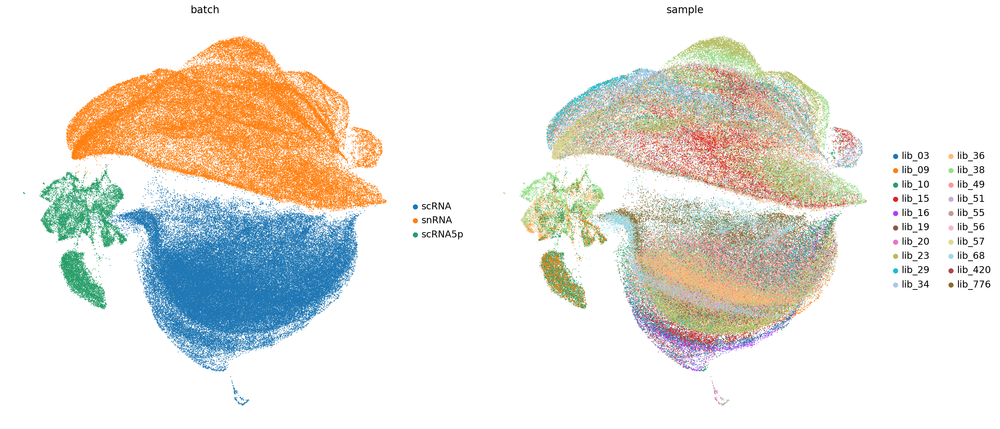

In [17]:
sc.settings.set_figure_params(figsize=('10', '10'), color_map='magma')
sc.pl.umap(adata, color = ['batch','sample'], frameon=False, size = 5, vmax='p99', legend_fontoutline=2)

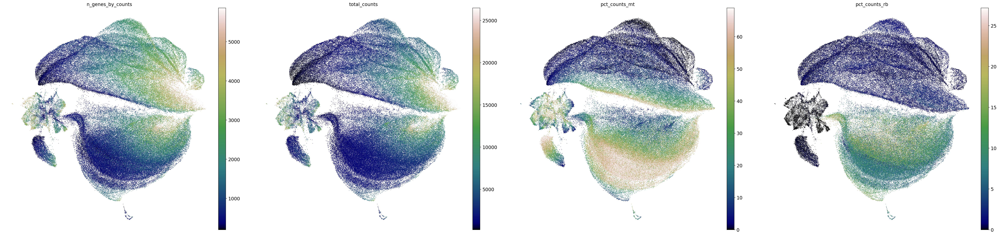

In [18]:
sc.settings.set_figure_params(figsize=('12', '12'), color_map='gist_earth')
sc.pl.umap(adata, color = ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_rb'], frameon=False, size = 5, vmax='p99', legend_fontoutline=2)

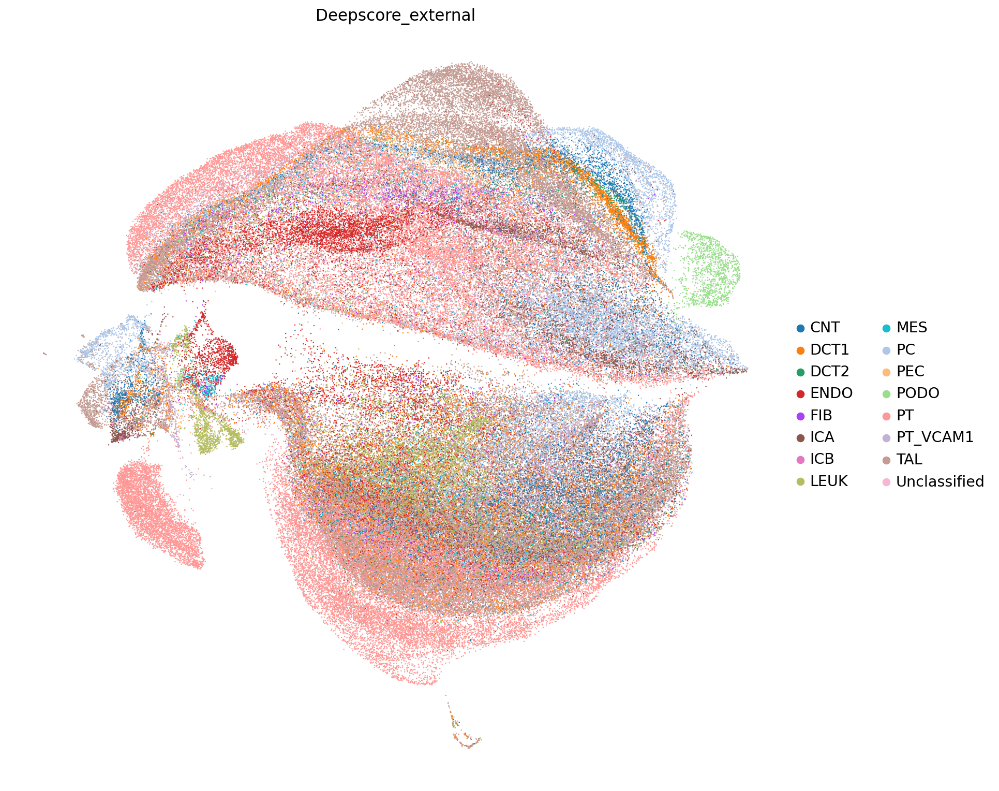

In [19]:
sc.pl.umap(adata, color = ['Deepscore_external'], frameon=False, size = 5, vmax='p99', legend_fontoutline=2)

In [20]:
adata_un = adata[adata.obs['Deepscore_external'].isin(['Unclassified'])]
adata_im = adata[adata.obs['Deepscore_external'].isin(['LEUK'])]
adata_non_im = adata[~adata.obs['Deepscore_external'].isin(['Unclassified','LEUK','PT','PT_VCAM'])]
adata_pt = adata[adata.obs['Deepscore_external'].isin(['PT','PT_VCAM'])]

## QC OVERVIEW

In [21]:
## PREVIOUS QC Threshold
mt_threshold = 70
rb_threshold = 40
nF_lower_threshold = 200
nF_upper_threshold = 7500
## Discarted for now # tc_upper_threshold = 16000

In [22]:
## Second round of QC
## For IMMUNE
mt_threshold_leuk = 10
## For Non Imm & Non PT
mt_mt_threshold_no_im = 20 # Only for cell with less than 500 genes
## For Non Imm & PT
mt_mt_threshold_no_im = 30 # Only for cell with less than 500 genes

In [23]:
adata

AnnData object with n_obs × n_vars = 191377 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [24]:
sc.settings.set_figure_params(figsize=('15', '5'), color_map='magma')


In [25]:
list_val = []
list_sample = []
for i in adata.obs['sample'].unique():
    prim = adata[adata.obs['sample'].isin([i])]
    list_val.append(np.sum(prim.obs['n_genes_by_counts'])/prim.shape[0])
    list_sample.append(i)
sort_l = np.argsort(list_val)
order = [list_sample[i] for i in sort_l]

## QC plots for Unclassified

In [26]:
adata_un

View of AnnData object with n_obs × n_vars = 3931 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

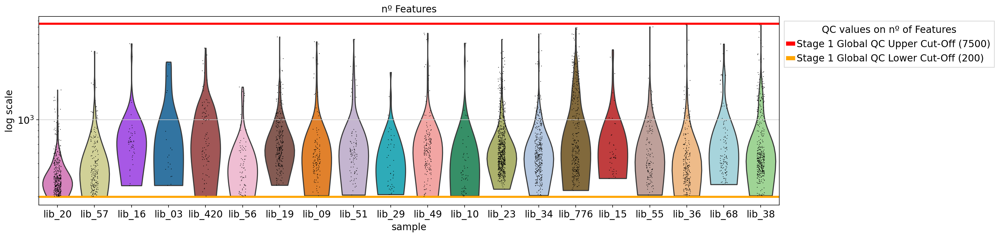

In [27]:
a = sc.pl.violin(adata_un, keys = ['n_genes_by_counts'] ,show=False, log = True, groupby='sample', order = order)
l1 = a.axhline(7500, color='red',linewidth = 3)
l1_5 = a.axhline(200, color='orange',linewidth = 3, )

# l2 = a.axhline(500, color='limegreen', label = '2ndQC NON-IMMUNE',linewidth = 3, linestyle = '--')
a.set_title('nº Features')
a.set_ylabel('log scale')
leg = a.legend([l1,l1_5],['Stage 1 Global QC Upper Cut-Off (7500)','Stage 1 Global QC Lower Cut-Off (200)','Stage 2 NON-IMMUNE QC Lower Cut-Off (500)'],fontsize = 14, title = 'QC values on nº of Features',
  fancybox=False, ncol=1,   bbox_to_anchor = (1,1))
for line in leg.get_lines():
    line.set_linewidth(6.0)
plt.savefig(f'figures/QC_violin_n_genes_by_counts.png', bbox_inches='tight', dpi=600)


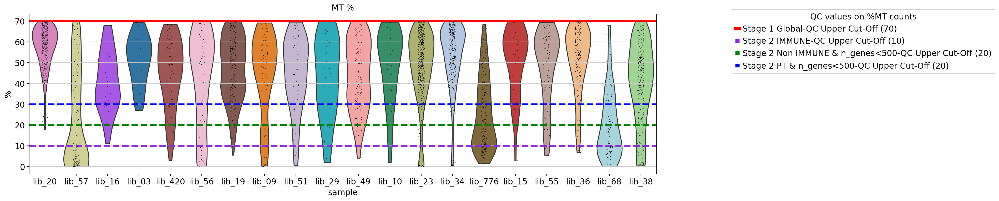

In [ ]:
a = sc.pl.violin(adata_un, keys = ['pct_counts_mt'] ,show=False, log = False, groupby='sample', order = order)
l1 = a.axhline(70, color='red',linewidth = 3)
l1_5 = a.axhline(10, color='blueviolet',linewidth = 3, linestyle = '--')
l2 = a.axhline(20, color='green',linewidth = 3, linestyle = '--')
l3= a.axhline(30, color='blue',linewidth = 3, linestyle = '--')
a.set_title('MT %')
a.set_ylabel('%')

leg = a.legend([l1,l1_5,l2,l3],['Stage 1 Global-QC Upper Cut-Off (70)','Stage 2 IMMUNE-QC Upper Cut-Off (10)','Stage 2 Non IMMUNE & n_genes<500-QC Upper Cut-Off (20)','Stage 2 PT & n_genes<500-QC Upper Cut-Off (20)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.33,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


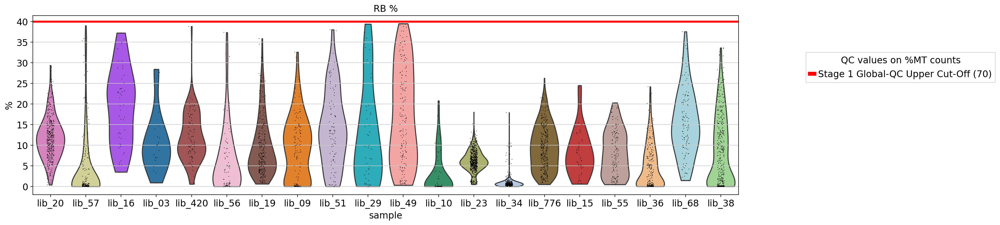

In [29]:
a = sc.pl.violin(adata_un, keys = ['pct_counts_rb'] ,show=False, log = False, groupby='sample', order = order)
l1 = a.axhline(40, color='red',linewidth = 3)


a.set_title('RB %')
a.set_ylabel('%')

leg = a.legend([l1],['Stage 1 Global-QC Upper Cut-Off (70)','Stage 2 IMMUNE-QC Upper Cut-Off (10)','Stage 2 Non IMMUNE & n_genes<500-QC Upper Cut-Off (20)','Stage 2 PT & n_genes<500-QC Upper Cut-Off (20)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.23,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


In [30]:
### FILTERING - Treated as UN

In [31]:
adata_un

View of AnnData object with n_obs × n_vars = 3931 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [32]:
filter_mask = (adata_un.obs['pct_counts_mt'] > 10) & (adata_un.obs['n_genes_by_counts'] < 500)
np.sum(filter_mask)

2101

In [33]:
adata_un = adata_un[~filter_mask]
adata_un

View of AnnData object with n_obs × n_vars = 1830 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

## QC plots for IMMUNE

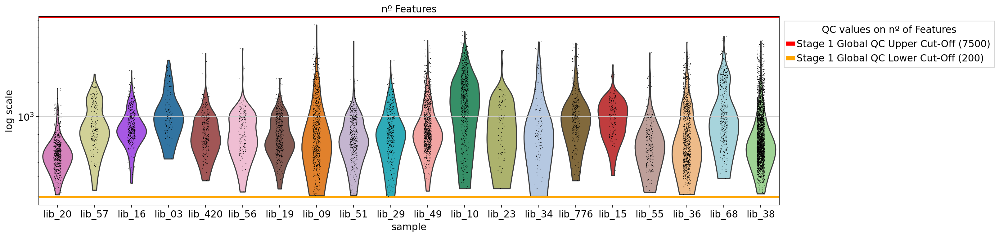

In [34]:
a = sc.pl.violin(adata_im, keys = ['n_genes_by_counts'] ,show=False, log = True, groupby='sample', order = order)
l1 = a.axhline(7500, color='red',linewidth = 3)
l1_5 = a.axhline(200, color='orange',linewidth = 3, )

# l2 = a.axhline(500, color='limegreen', label = '2ndQC NON-IMMUNE',linewidth = 3, linestyle = '--')
a.set_title('nº Features')
a.set_ylabel('log scale')
leg = a.legend([l1,l1_5],['Stage 1 Global QC Upper Cut-Off (7500)','Stage 1 Global QC Lower Cut-Off (200)'],fontsize = 14, title = 'QC values on nº of Features',
  fancybox=False, ncol=1,   bbox_to_anchor = (1,1))
for line in leg.get_lines():
    line.set_linewidth(6.0)
plt.savefig(f'figures/QC_violin_n_genes_by_counts.png', bbox_inches='tight', dpi=600)


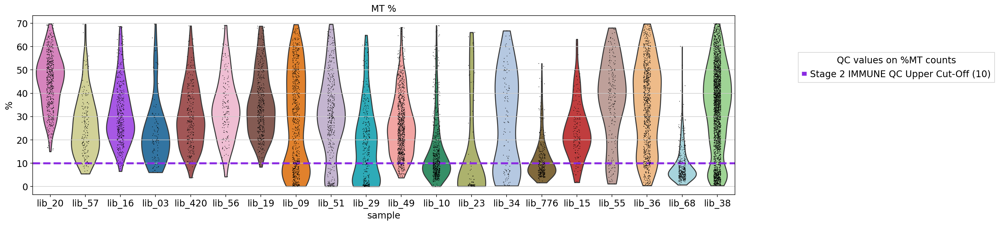

In [35]:
a = sc.pl.violin(adata_im, keys = ['pct_counts_mt'] ,show=False, log = False, groupby='sample', order = order)
# l1 = a.axhline(70, color='red',linewidth = 3)
l1_5 = a.axhline(10, color='blueviolet',linewidth = 3, linestyle = '--')
a.set_title('MT %')
a.set_ylabel('%')

leg = a.legend([l1_5],['Stage 2 IMMUNE QC Upper Cut-Off (10)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.23,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


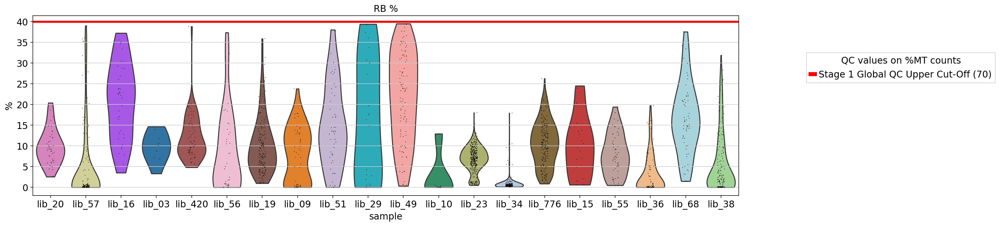

In [36]:
a = sc.pl.violin(adata_un, keys = ['pct_counts_rb'] ,show=False, log = False, groupby='sample', order = order)
l1 = a.axhline(40, color='red',linewidth = 3)
# l1_5 = a.axhline(10, color='blueviolet',linewidth = 3, linestyle = '--')
a.set_title('RB %')
a.set_ylabel('%')

leg = a.legend([l1],['Stage 1 Global QC Upper Cut-Off (70)','Stage 2 IMMUNE QC Upper Cut-Off (10)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.23,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


In [37]:
### FILTERING

In [38]:
adata_im

View of AnnData object with n_obs × n_vars = 10064 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [39]:
filter_mask = (adata_im.obs['pct_counts_mt'] > 10)# & (adata.obs['n_genes_by_counts'] < 500)
np.sum(filter_mask)

8114

In [40]:
adata_im = adata_im[~filter_mask]
adata_im

View of AnnData object with n_obs × n_vars = 1950 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

## QC plots for Non IMM & Non PT

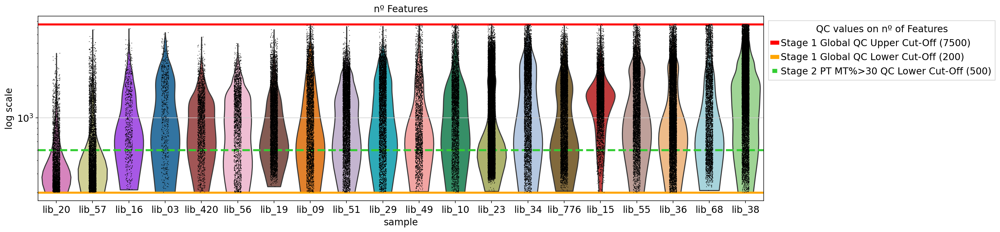

In [41]:
a = sc.pl.violin(adata_non_im, keys = ['n_genes_by_counts'] ,show=False, log = True, groupby='sample', order = order)
l1 = a.axhline(7500, color='red',linewidth = 3)
l1_5 = a.axhline(200, color='orange',linewidth = 3, )

l2 = a.axhline(500, color='limegreen', label = '2ndQC NON-IMMUNE',linewidth = 3, linestyle = '--')
a.set_title('nº Features')
a.set_ylabel('log scale')
leg = a.legend([l1,l1_5,l2],['Stage 1 Global QC Upper Cut-Off (7500)','Stage 1 Global QC Lower Cut-Off (200)','Stage 2 PT MT%>30 QC Lower Cut-Off (500)'],fontsize = 14, title = 'QC values on nº of Features',
  fancybox=False, ncol=1,   bbox_to_anchor = (1,1))
for line in leg.get_lines():
    line.set_linewidth(6.0)
plt.savefig(f'figures/QC_violin_n_genes_by_counts.png', bbox_inches='tight', dpi=600)


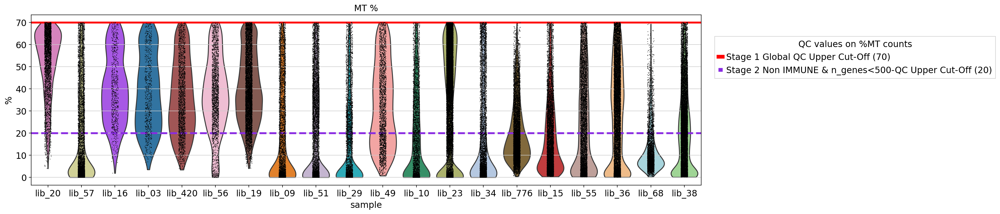

In [42]:
a = sc.pl.violin(adata_non_im, keys = ['pct_counts_mt'] ,show=False, log = False, groupby='sample', order = order)
l1 = a.axhline(70, color='red',linewidth = 3)
l1_5 = a.axhline(20, color='blueviolet',linewidth = 3, linestyle = '--')
a.set_title('MT %')
a.set_ylabel('%')

leg = a.legend([l1,l1_5],['Stage 1 Global QC Upper Cut-Off (70)','Stage 2 Non IMMUNE & n_genes<500-QC Upper Cut-Off (20)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.23,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


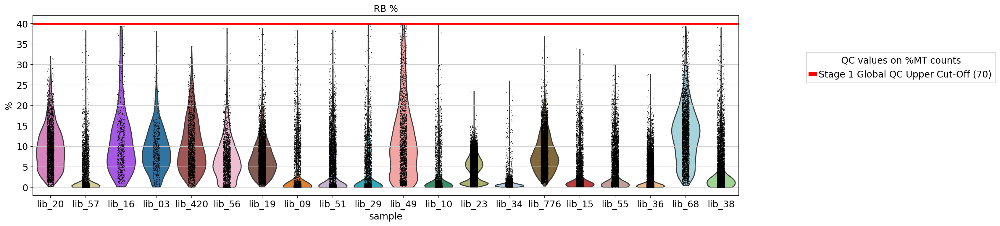

In [43]:
a = sc.pl.violin(adata_non_im, keys = ['pct_counts_rb'] ,show=False, log = False, groupby='sample', order = order)
l1 = a.axhline(40, color='red',linewidth = 3)
# l1_5 = a.axhline(10, color='blueviolet',linewidth = 3, linestyle = '--')
a.set_title('RB %')
a.set_ylabel('%')

leg = a.legend([l1],['Stage 1 Global QC Upper Cut-Off (70)','Stage 2 IMMUNE QC Upper Cut-Off (10)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.23,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


In [44]:
### FILTERING

In [45]:
adata_non_im

View of AnnData object with n_obs × n_vars = 132091 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [46]:
filter_mask = (adata_non_im.obs['pct_counts_mt'] > 20) & (adata_non_im.obs['n_genes_by_counts'] < 500)
np.sum(filter_mask)

21433

In [47]:
adata_non_im = adata_non_im[~filter_mask]
adata_non_im

View of AnnData object with n_obs × n_vars = 110658 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

## QC plots for PT

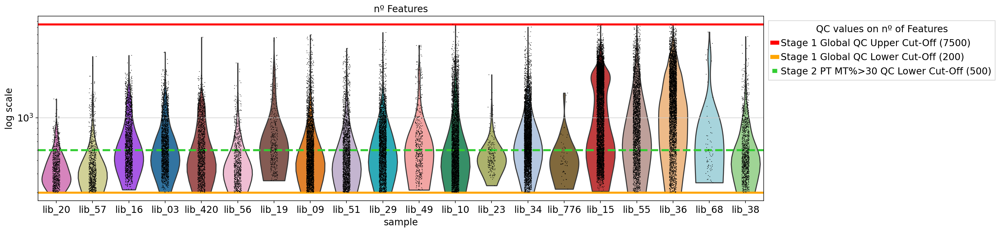

In [48]:
a = sc.pl.violin(adata_pt, keys = ['n_genes_by_counts'] ,show=False, log = True, groupby='sample', order = order)
l1 = a.axhline(7500, color='red',linewidth = 3)
l1_5 = a.axhline(200, color='orange',linewidth = 3, )

l2 = a.axhline(500, color='limegreen', label = '2ndQC NON-IMMUNE',linewidth = 3, linestyle = '--')
a.set_title('nº Features')
a.set_ylabel('log scale')
leg = a.legend([l1,l1_5,l2],['Stage 1 Global QC Upper Cut-Off (7500)','Stage 1 Global QC Lower Cut-Off (200)','Stage 2 PT MT%>30 QC Lower Cut-Off (500)'],fontsize = 14, title = 'QC values on nº of Features',
  fancybox=False, ncol=1,   bbox_to_anchor = (1,1))
for line in leg.get_lines():
    line.set_linewidth(6.0)
plt.savefig(f'figures/QC_violin_n_genes_by_counts.png', bbox_inches='tight', dpi=600)


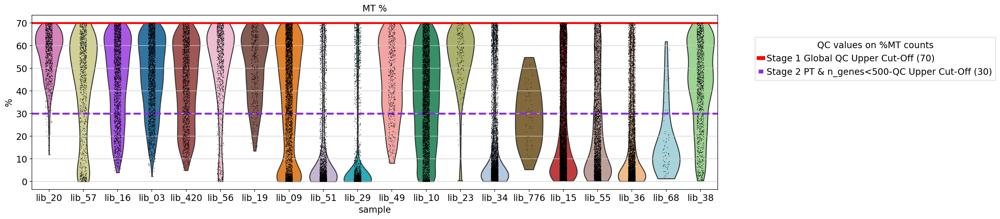

In [49]:
a = sc.pl.violin(adata_pt, keys = ['pct_counts_mt'] ,show=False, log = False, groupby='sample', order = order)
l1 = a.axhline(70, color='red',linewidth = 3)
l1_5 = a.axhline(30, color='blueviolet',linewidth = 3, linestyle = '--')
a.set_title('MT %')
a.set_ylabel('%')

leg = a.legend([l1,l1_5],['Stage 1 Global QC Upper Cut-Off (70)','Stage 2 PT & n_genes<500-QC Upper Cut-Off (30)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.23,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


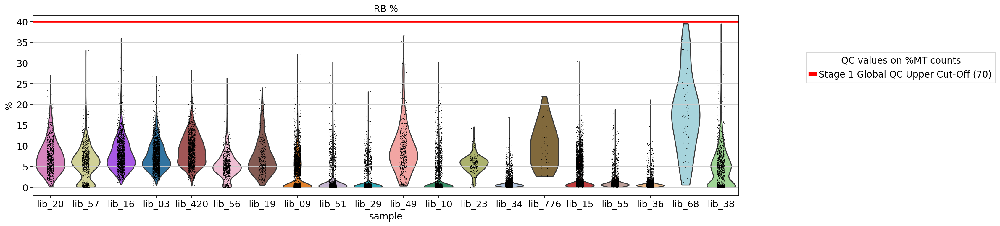

In [50]:
a = sc.pl.violin(adata_pt, keys = ['pct_counts_rb'] ,show=False, log = False, groupby='sample', order = order)
l1 = a.axhline(40, color='red',linewidth = 3)
# l1_5 = a.axhline(10, color='blueviolet',linewidth = 3, linestyle = '--')
a.set_title('RB %')
a.set_ylabel('%')

leg = a.legend([l1],['Stage 1 Global QC Upper Cut-Off (70)','Stage 2 IMMUNE QC Upper Cut-Off (10)'],loc = 'lower center',fontsize = 14, title = 'QC values on %MT counts',
  fancybox=False, ncol=1,   bbox_to_anchor = (1.23,0.6))
for line in leg.get_lines():
    line.set_linewidth(6.0)
# plt.savefig(f'figures/QC_violins/pct_counts_mt.png', bbox_inches='tight',dpi=600)


In [51]:
### FILTERING

In [52]:
adata_pt

View of AnnData object with n_obs × n_vars = 45291 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [53]:
filter_mask = (adata_pt.obs['pct_counts_mt'] > 30) & (adata_pt.obs['n_genes_by_counts'] < 500)
np.sum(filter_mask)

12087

In [54]:
adata_pt = adata_pt[~filter_mask]
adata_pt

View of AnnData object with n_obs × n_vars = 33204 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [55]:
## Concatenating

In [56]:
adata_un = adata[adata.obs['Deepscore_external'].isin(['Unclassified'])]
adata_im = adata[adata.obs['Deepscore_external'].isin(['LEUK'])]
adata_non_im = adata[~adata.obs['Deepscore_external'].isin(['Unclassified','LEUK','PT','PT_VCAM'])]
adata_pt

View of AnnData object with n_obs × n_vars = 33204 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    uns: 'batch_colors', 'sample_colors', 'pca', 'neighbors', 'umap', 'Deepscore_external_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [57]:
adata = sc.concat([adata_un, adata_im,adata_non_im, adata_pt], index_unique=None)

In [58]:
adata

AnnData object with n_obs × n_vars = 179290 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [ ]:
adata.write('objects/Integration_2ndQC.h5ad', compression='gzip')